### [执行一次即可]转换前向模型并保存

In [4]:
trained_model_path = 'models/resnet50_csv_20.h5'
inference_model_save_path = "models/RetinaNet/retinanet_inference.h5"

In [2]:
import subprocess

convert_command = ['python', 'keras-retinanet/keras_retinanet/bin/convert_model.py', '--no-class-specific-filter', trained_model_path, inference_model_save_path]
print('开始模型转换...')
process = subprocess.Popen(convert_command)
process.wait()
if process.returncode != 0:
    print(f"模型转换失败，失败码：{process.returncode}")
else:
    print('模型转换成功!')

开始模型转换...
模型转换成功!


In [1]:
from tensorflow import keras as keras
from PIL import Image

import tensorflow as tf
import numpy as np

keras.backend.clear_session()  # For easy reset of notebook state.

gpus = tf.config.experimental.list_physical_devices('GPU')
tf.config.set_visible_devices(devices=gpus[0], device_type="GPU")

### 加载检测器 detector

In [2]:
# show images inline
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
import keras

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
from keras_retinanet.utils.gpu import setup_gpu

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time

# use this to change which GPU to use
#gpu = 0

# set the modified tf session as backend in keras
#setup_gpu(gpu)

In [5]:
detector = models.load_model(inference_model_save_path, backbone_name='resnet50')

In [6]:
detector.summary()

Model: "retinanet-bbox"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, None, None, 6 9408        input_1[0][0]                    
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, None, None, 6 256         conv1[0][0]                      
__________________________________________________________________________________________________
conv1_relu (Activation)         (None, None, None, 6 0           bn_conv1[0][0]                   
_____________________________________________________________________________________

### 加载检测 类别名称 detector_class_name

In [18]:
import pandas as pd

df = pd.read_csv("data/baijiu/class.csv", header=None)

# load label to names mapping for visualization purposes
detector_class_name = df[0].values.tolist()

In [19]:
detector_class_name

['box', 'others', 'bucket', 'bottle', 'bag', 'jar']

### 加载分类器 classifier

In [20]:
import tensorflow as tf

classifier = tf.keras.models.load_model("models/ResNet50/ResNet50_classified.h5")

In [21]:
classifier.summary()

Model: "ResNet50_classified"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, None, None, 3 0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, None, None, 6 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, None, None, 6 256         conv1_conv[0][0]                 
________________________________________________________________________________

### [执行一次即可]提取分类 类别名称 classifier_class_name

In [22]:
train_dataset_path = "data/classified/train"

import os
classifier_class_name = list(
    filter(
        lambda x: not x.startswith(".")
        and os.path.isdir(os.path.join(train_dataset_path, x)),
        os.listdir(train_dataset_path),
    )
)
print(f"类别总数：{len(classifier_class_name)}")

类别总数：166


In [23]:
classifier_class_name

['RIO蓝',
 '一品苏黄',
 '三件购物陈年糟烧白酒50度2.5L',
 '三杯香',
 '三江购物老北京二锅头52度5L',
 '三鞭酒',
 '东风糟烧2.5L',
 '二锅头酒',
 '五粮液52度100年传奇佳酿500ml',
 '五粮醇',
 '今世缘',
 '伊力52度十年老陈酒250ml',
 '养生泰',
 '剑南',
 '劲酒',
 '北京二锅头56度500ml',
 '北京二锅头56度5L',
 '北京二锅头蓝2L',
 '北京二锅头酒500ml',
 '北京军功二锅头',
 '北京军功二锅头100ml',
 '北京军功二锅头酒2L',
 '北京革命小酒',
 '双沟',
 '口子窖',
 '古井45度陈酿酒450ml',
 '古井50度玉液酒450ml',
 '古井囍酒500ml',
 '古井大曲500ml',
 '古井贡酒G3年份原浆500ml',
 '古井贡酒G9年份原浆500ml',
 '古川',
 '古越龙山42度陈年烧酒2.5L',
 '古越龙山三年老陈酒',
 '古越龙山五年陈酒500ml',
 '古越龙山清醇三年500ml',
 '古越龙山绍兴黄酒花雕糯米酒',
 '四川红高粱',
 '四川高粱酒',
 '四特酒',
 '国窖经典盒装',
 '塔牌42度陈年烧白酒2.5L',
 '大明老白干',
 '女儿红烧酒50度3L',
 '女儿红绍兴黄酒老酒500ml',
 '宣酒',
 '小糊涂仙52度500ml',
 '小郎酒45度',
 '小郎酒45度炫彩小瓶100ml',
 '尖庄',
 '尖庄500ml',
 '店小二',
 '恒顺老酒',
 '杜康',
 '枝江',
 '柔和',
 '歪嘴52度100ml',
 '毛铺',
 '毛铺苦荞酒42度425ml',
 '永丰北京二锅头42度出口小方瓶100ml、500ml',
 '永丰北京二锅头56度5L',
 '永丰牌北京二锅头42度小方瓶500ml',
 '永丰陈酿42度500ml',
 '江小白40度JOYYOUTH500ml',
 '江小白40度Straight高粱酒300ml',
 '江小白Se.100 40度300ml',
 '汾酒42度红盖玻汾475ml',
 '沙洲',
 '泰山老陈酒15窖藏500ml',
 '泸州',
 '泸州老白干52度2.5L、5L',


### 保存类别名称文件

In [24]:
with open("models/ResNet50/ResNet50_classified_class.txt", "w+") as f:
    f.write(str(classifier_class_name))

### 加载类别名称文件

In [25]:
with open("models/ResNet50/ResNet50_classified_class.txt", "r+") as f:
    classifier_class_name = eval(f.read())

In [26]:
classifier_class_name[:10]

['RIO蓝',
 '一品苏黄',
 '三件购物陈年糟烧白酒50度2.5L',
 '三杯香',
 '三江购物老北京二锅头52度5L',
 '三鞭酒',
 '东风糟烧2.5L',
 '二锅头酒',
 '五粮液52度100年传奇佳酿500ml',
 '五粮醇']

## 检测+分类

In [27]:
def load_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_tensor = image.img_to_array(img)                    
    img_tensor = np.expand_dims(img_tensor, axis=0)         
    img_tensor /= 255.                                      

    plt.imshow(img_tensor[0])                           
    plt.axis('off')
    plt.show()

    return img_tensor

In [28]:
# 商品检测
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.imagenet_utils import preprocess_input

test_image_path = 'test_1.jpg'
test_dir = "test/"

# 读取图像
input_image = read_image_bgr(test_image_path)

# 预处理
input_image = preprocess_image(input_image)
input_image, scale = resize_image(input_image)

# 计时开始
start = time.time()
# 商品检测
boxes, scores, labels = detector.predict_on_batch(np.expand_dims(input_image, axis=0))

# 图像尺寸矫正
boxes /= scale

In [29]:
# 分类结果画图，重新读取原图
draw = read_image_bgr(test_image_path).copy()
draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

In [30]:
# 记录分类结果
idx = 0
predict_list = []

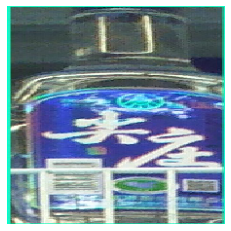

37 四川红高粱 0.9407621026039124


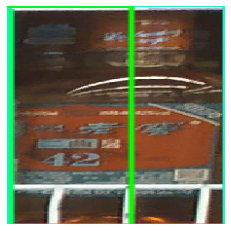

9 五粮醇 0.7819411754608154


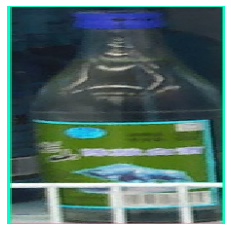

101 牛栏山42度陈酿白酒750ml 0.4643692672252655


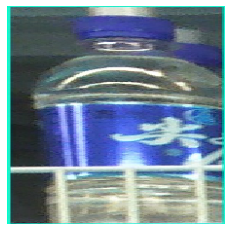

47 小郎酒45度 0.6033204793930054


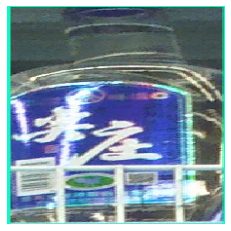

37 四川红高粱 0.868056058883667


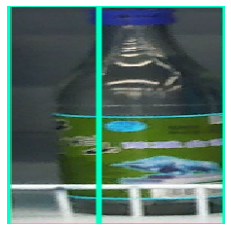

140 老村长 0.291246235370636


/root/.local/lib/python3.8/site-packages/keras_retinanet/utils/colors.py:18: UserWarning: Label 140 has no color, returning default.
  warnings.warn('Label {} has no color, returning default.'.format(label))


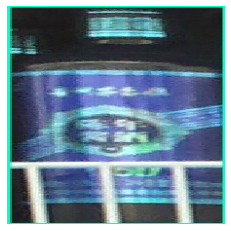

141 老村长38度流金溢彩450ml 0.5472332239151001


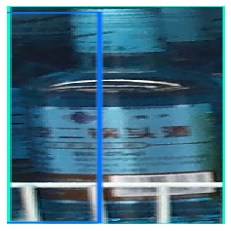

9 五粮醇 0.7164140343666077


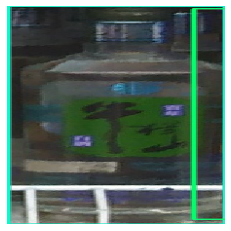

9 五粮醇 0.7792248725891113


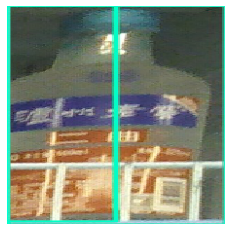

90 牛栏山41.6度小牛白酒500ml 0.6555947065353394


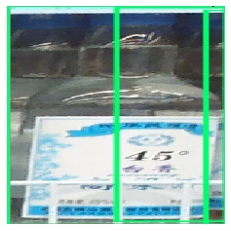

141 老村长38度流金溢彩450ml 0.3505879044532776


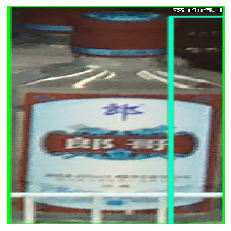

141 老村长38度流金溢彩450ml 0.8912513852119446


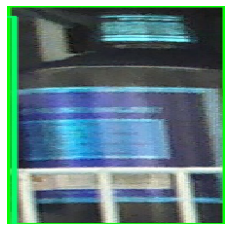

140 老村长 0.5346352458000183


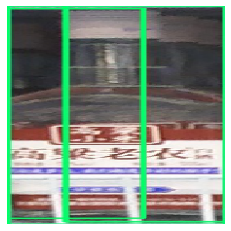

9 五粮醇 0.40904515981674194


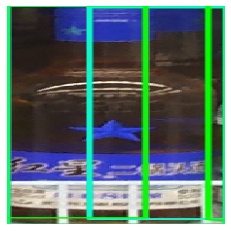

47 小郎酒45度 0.36959391832351685


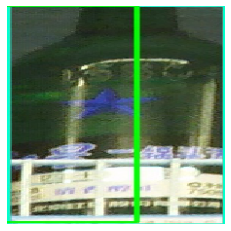

9 五粮醇 0.46999242901802063


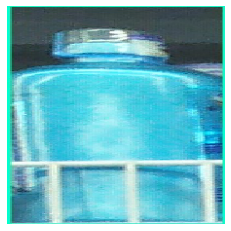

90 牛栏山41.6度小牛白酒500ml 0.33482083678245544


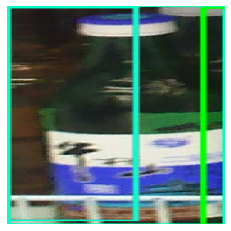

90 牛栏山41.6度小牛白酒500ml 0.8643202781677246


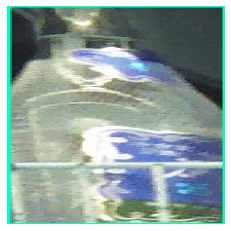

103 牛栏山43度珍品陈酿白酒500ml 0.24776186048984528


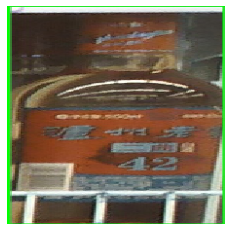

9 五粮醇 0.7538236975669861


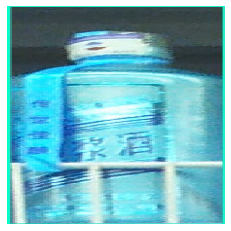

9 五粮醇 0.3539171814918518


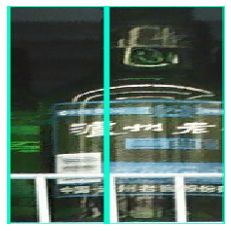

37 四川红高粱 0.7464462518692017


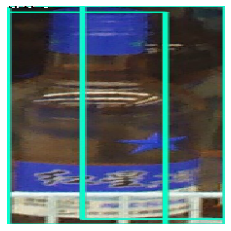

163 青瓷潭 0.7446848154067993


/root/.local/lib/python3.8/site-packages/keras_retinanet/utils/colors.py:18: UserWarning: Label 163 has no color, returning default.
  warnings.warn('Label {} has no color, returning default.'.format(label))


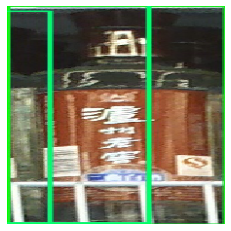

47 小郎酒45度 0.46575728058815


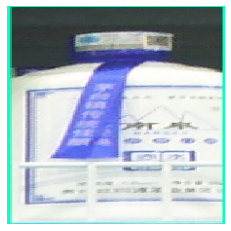

47 小郎酒45度 0.2033102959394455


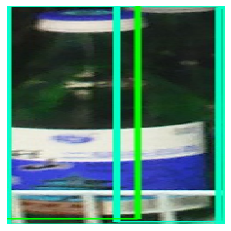

90 牛栏山41.6度小牛白酒500ml 0.9528375267982483


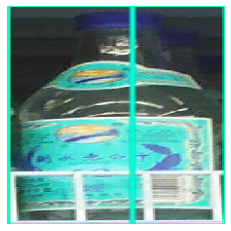

141 老村长38度流金溢彩450ml 0.7799572348594666


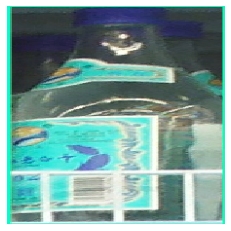

48 小郎酒45度炫彩小瓶100ml 0.36438071727752686


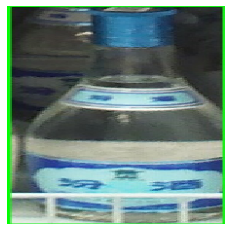

108 牛栏山53度二锅头净爽500ml 0.40636181831359863


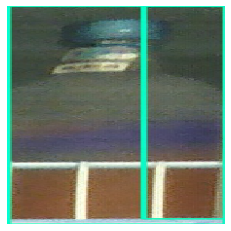

90 牛栏山41.6度小牛白酒500ml 0.8909739851951599


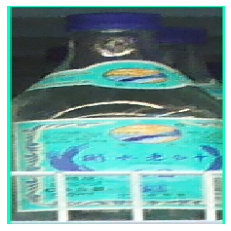

101 牛栏山42度陈酿白酒750ml 0.31151148676872253


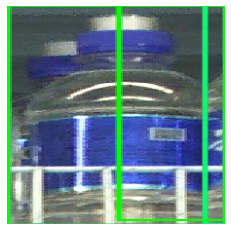

140 老村长 0.4465616047382355


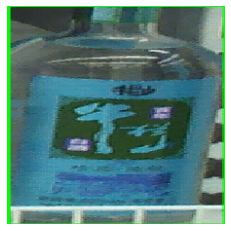

90 牛栏山41.6度小牛白酒500ml 0.9681460857391357


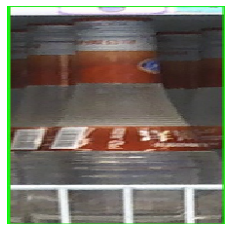

9 五粮醇 0.49220022559165955


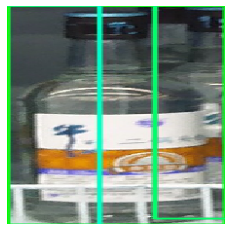

108 牛栏山53度二锅头净爽500ml 0.8921859264373779


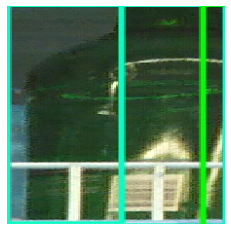

90 牛栏山41.6度小牛白酒500ml 0.9590485692024231


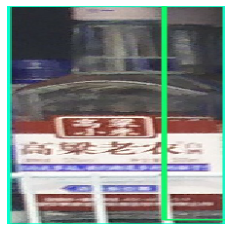

37 四川红高粱 0.7078708410263062


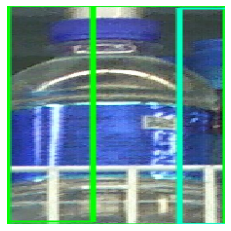

141 老村长38度流金溢彩450ml 0.7798136472702026


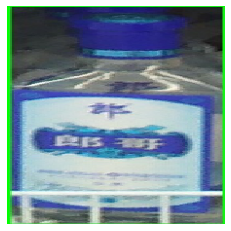

141 老村长38度流金溢彩450ml 0.4855678975582123


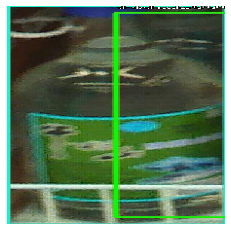

9 五粮醇 0.592462420463562


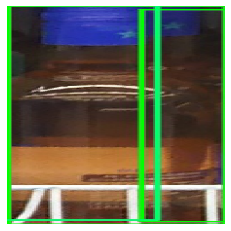

90 牛栏山41.6度小牛白酒500ml 0.6373767852783203


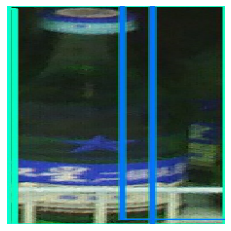

163 青瓷潭 0.8837848901748657


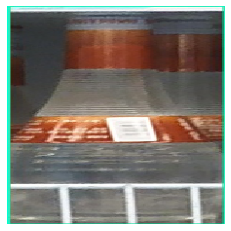

9 五粮醇 0.7127000689506531


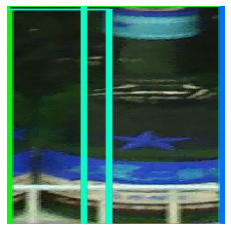

90 牛栏山41.6度小牛白酒500ml 0.5132643580436707


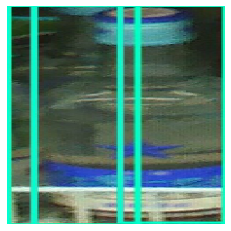

90 牛栏山41.6度小牛白酒500ml 0.6316847801208496


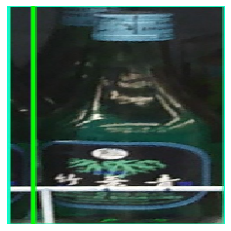

90 牛栏山41.6度小牛白酒500ml 0.6145728826522827


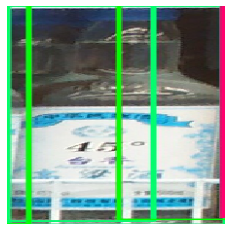

141 老村长38度流金溢彩450ml 0.7260085344314575


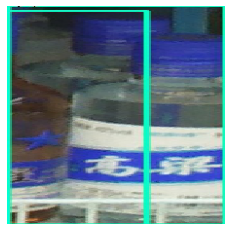

108 牛栏山53度二锅头净爽500ml 0.3848351836204529


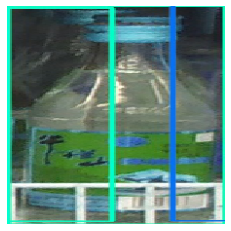

90 牛栏山41.6度小牛白酒500ml 0.8587262034416199


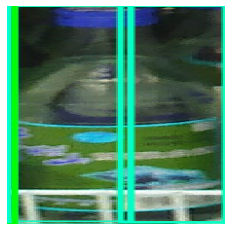

90 牛栏山41.6度小牛白酒500ml 0.6540537476539612


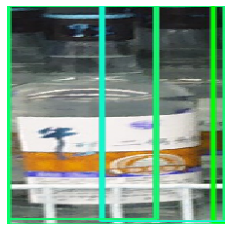

45 宣酒 0.34449195861816406


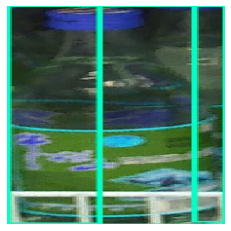

9 五粮醇 0.5162250399589539


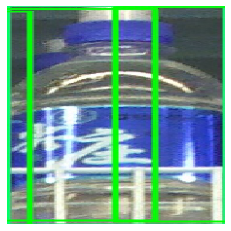

45 宣酒 0.7060360312461853


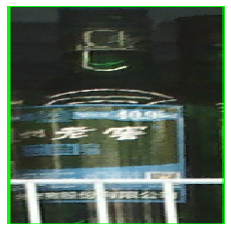

37 四川红高粱 0.8396315574645996


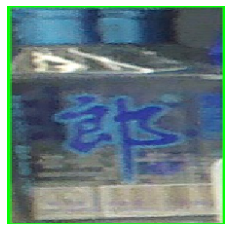

157 道光 0.38071319460868835


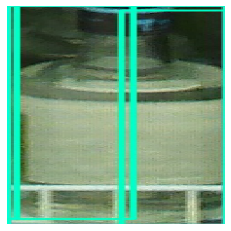

88 洋河蓝色经典52度天之蓝480ml 0.5824525356292725


/root/.local/lib/python3.8/site-packages/keras_retinanet/utils/colors.py:18: UserWarning: Label 88 has no color, returning default.
  warnings.warn('Label {} has no color, returning default.'.format(label))


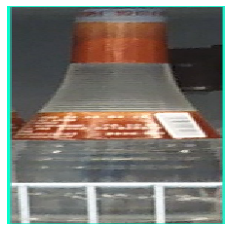

9 五粮醇 0.9028676152229309


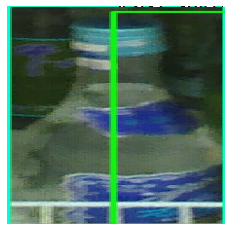

9 五粮醇 0.6499645709991455


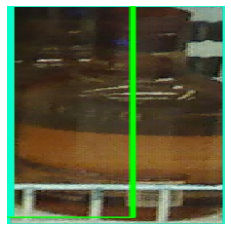

9 五粮醇 0.5477274656295776


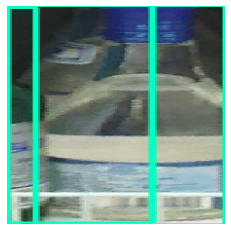

90 牛栏山41.6度小牛白酒500ml 0.9004952907562256


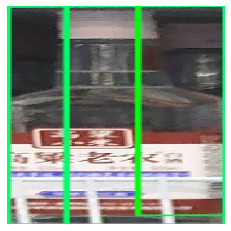

101 牛栏山42度陈酿白酒750ml 0.31724366545677185


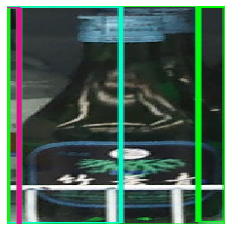

90 牛栏山41.6度小牛白酒500ml 0.7326820492744446


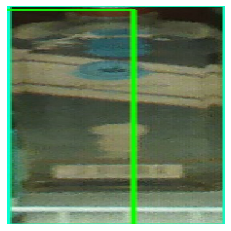

90 牛栏山41.6度小牛白酒500ml 0.585905909538269


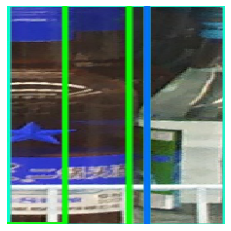

90 牛栏山41.6度小牛白酒500ml 0.9108700156211853


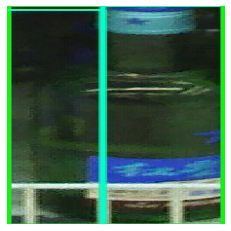

90 牛栏山41.6度小牛白酒500ml 0.4577677249908447


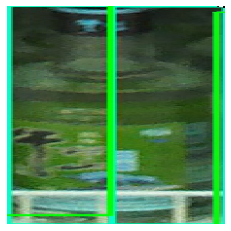

90 牛栏山41.6度小牛白酒500ml 0.7590010166168213


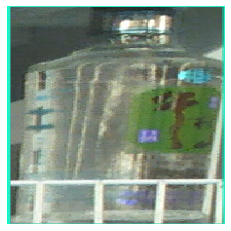

9 五粮醇 0.5696861743927002


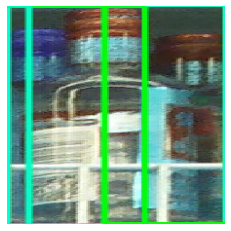

90 牛栏山41.6度小牛白酒500ml 0.5892562866210938


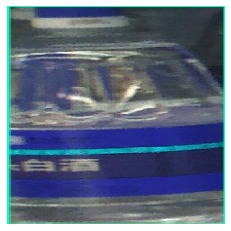

90 牛栏山41.6度小牛白酒500ml 0.38958996534347534


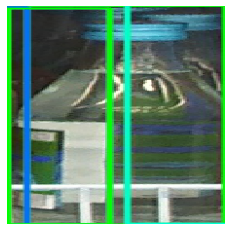

90 牛栏山41.6度小牛白酒500ml 0.9867992997169495


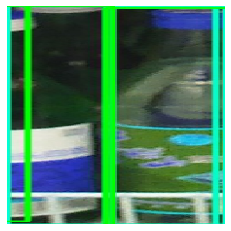

9 五粮醇 0.6151102185249329


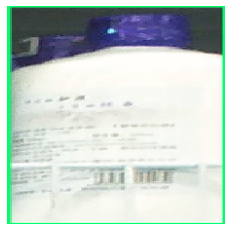

157 道光 0.25222933292388916


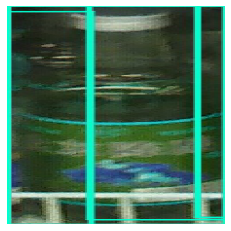

9 五粮醇 0.6179170608520508


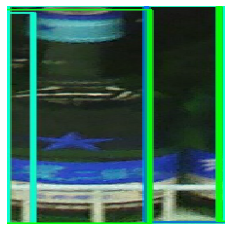

9 五粮醇 0.7810254693031311


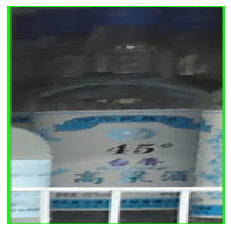

9 五粮醇 0.6610988974571228


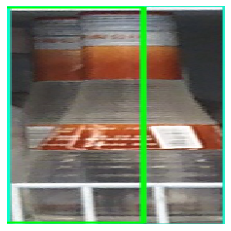

9 五粮醇 0.6853861808776855


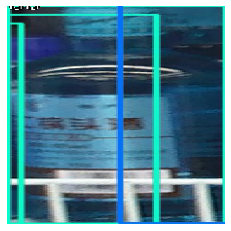

9 五粮醇 0.5099436044692993


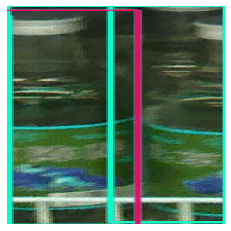

90 牛栏山41.6度小牛白酒500ml 0.9673511385917664


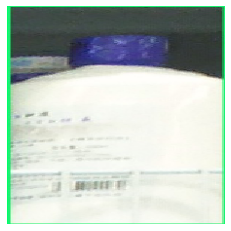

157 道光 0.3873792290687561


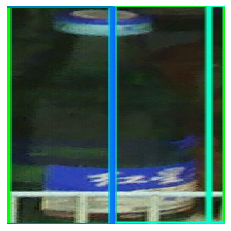

163 青瓷潭 0.5424692034721375


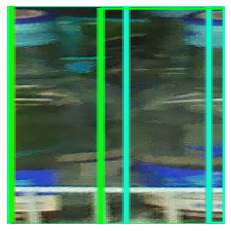

90 牛栏山41.6度小牛白酒500ml 0.5168986916542053


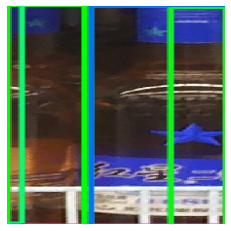

90 牛栏山41.6度小牛白酒500ml 0.6887911558151245


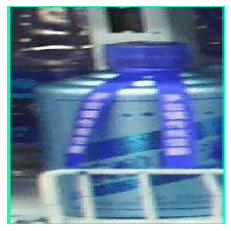

140 老村长 0.2729319632053375


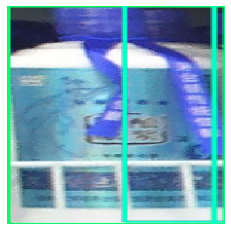

90 牛栏山41.6度小牛白酒500ml 0.49313145875930786


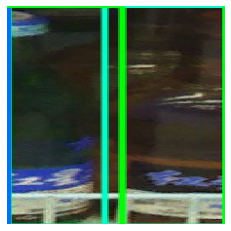

90 牛栏山41.6度小牛白酒500ml 0.8704890012741089


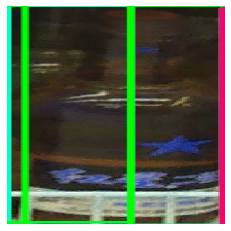

9 五粮醇 0.6112075448036194


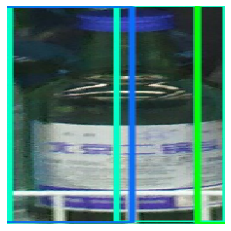

90 牛栏山41.6度小牛白酒500ml 0.5878220200538635


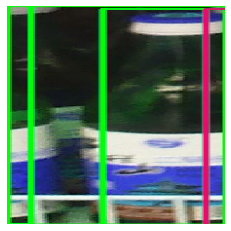

90 牛栏山41.6度小牛白酒500ml 0.7774448394775391


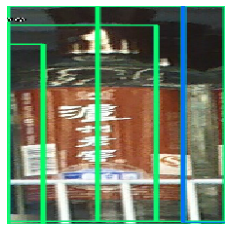

45 宣酒 0.3678523004055023


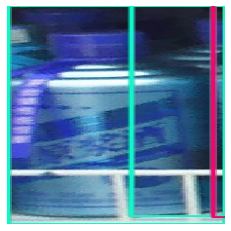

141 老村长38度流金溢彩450ml 0.30795007944107056


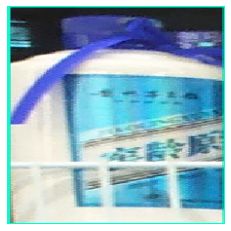

47 小郎酒45度 0.5035830736160278


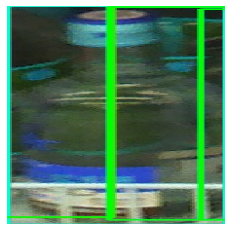

9 五粮醇 0.7059023976325989


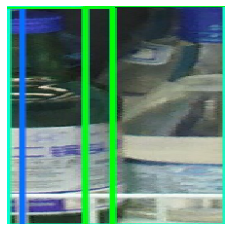

90 牛栏山41.6度小牛白酒500ml 0.8853570818901062


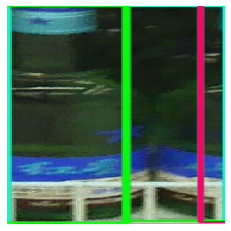

90 牛栏山41.6度小牛白酒500ml 0.5613518953323364


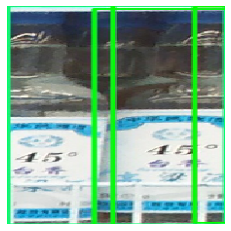

141 老村长38度流金溢彩450ml 0.5411497354507446


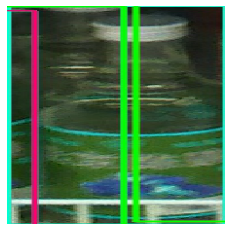

9 五粮醇 0.8118166923522949


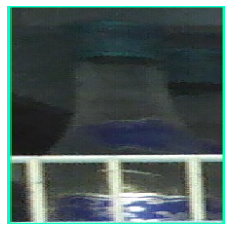

90 牛栏山41.6度小牛白酒500ml 0.4743198752403259


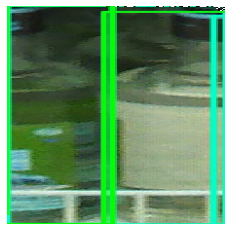

90 牛栏山41.6度小牛白酒500ml 0.7625998854637146


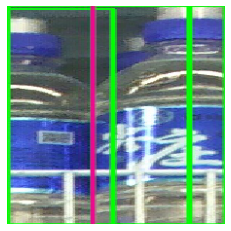

9 五粮醇 0.4095022678375244


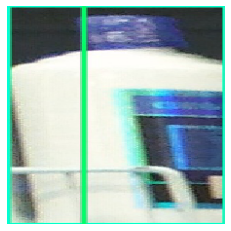

90 牛栏山41.6度小牛白酒500ml 0.35511496663093567


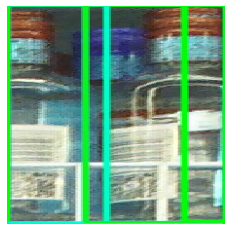

90 牛栏山41.6度小牛白酒500ml 0.7560498714447021


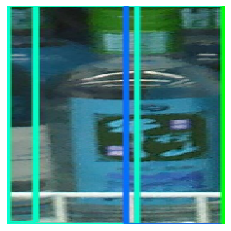

90 牛栏山41.6度小牛白酒500ml 0.5846285820007324


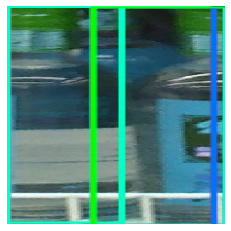

90 牛栏山41.6度小牛白酒500ml 0.9856971502304077


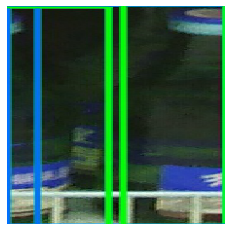

90 牛栏山41.6度小牛白酒500ml 0.9832884669303894


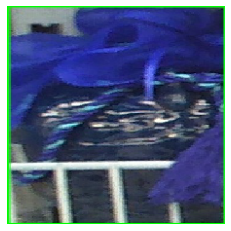

90 牛栏山41.6度小牛白酒500ml 0.8379865288734436


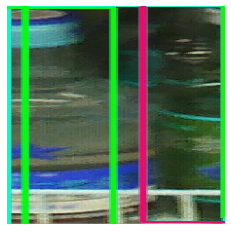

9 五粮醇 0.5927846431732178


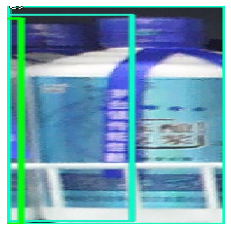

9 五粮醇 0.47928619384765625


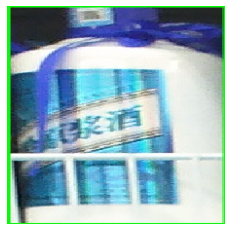

90 牛栏山41.6度小牛白酒500ml 0.5582489371299744


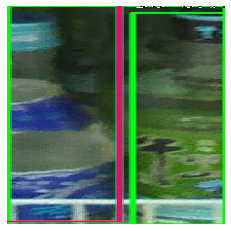

90 牛栏山41.6度小牛白酒500ml 0.596365749835968


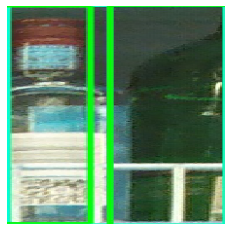

90 牛栏山41.6度小牛白酒500ml 0.8785317540168762


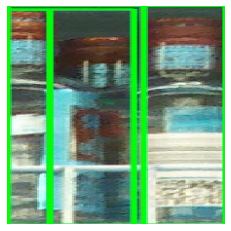

90 牛栏山41.6度小牛白酒500ml 0.7234973311424255


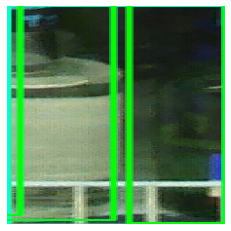

90 牛栏山41.6度小牛白酒500ml 0.4516458511352539


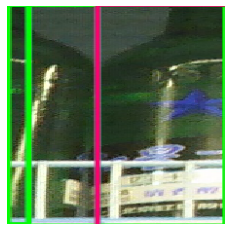

90 牛栏山41.6度小牛白酒500ml 0.7636238932609558


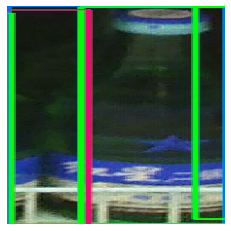

90 牛栏山41.6度小牛白酒500ml 0.5036547780036926


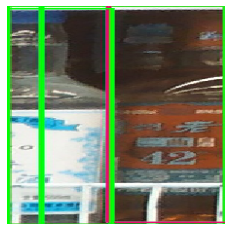

9 五粮醇 0.5130521059036255


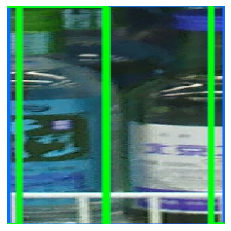

90 牛栏山41.6度小牛白酒500ml 0.6433386206626892


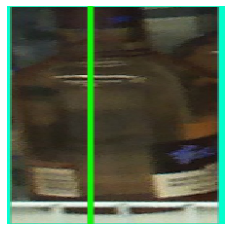

9 五粮醇 0.9631744623184204


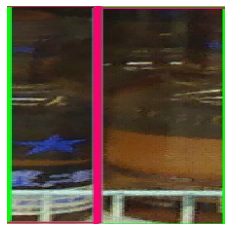

9 五粮醇 0.6761719584465027


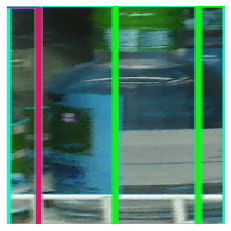

90 牛栏山41.6度小牛白酒500ml 0.5729639530181885


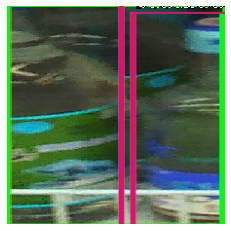

9 五粮醇 0.615009605884552


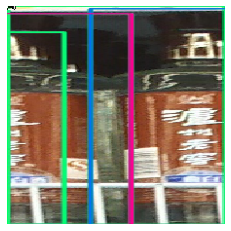

47 小郎酒45度 0.6727049350738525


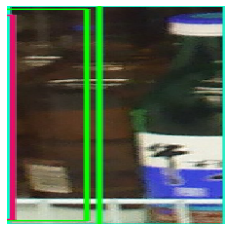

90 牛栏山41.6度小牛白酒500ml 0.6484249234199524


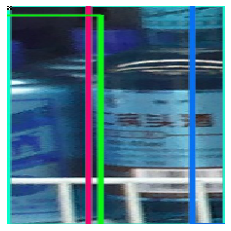

140 老村长 0.5806836485862732


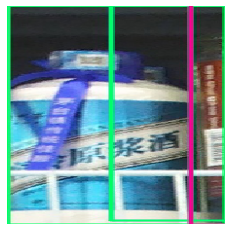

141 老村长38度流金溢彩450ml 0.6401657462120056


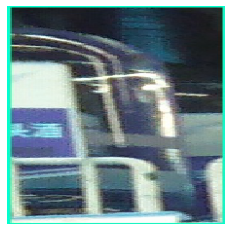

90 牛栏山41.6度小牛白酒500ml 0.9954845905303955


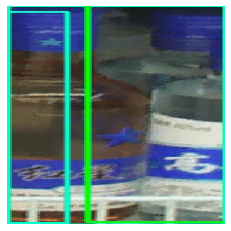

90 牛栏山41.6度小牛白酒500ml 0.889482855796814


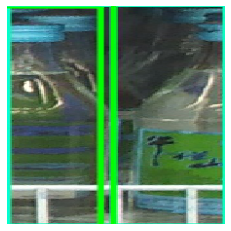

90 牛栏山41.6度小牛白酒500ml 0.8610800504684448


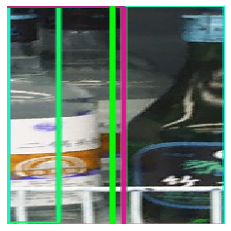

90 牛栏山41.6度小牛白酒500ml 0.5346224308013916


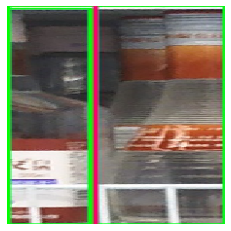

9 五粮醇 0.6271679401397705


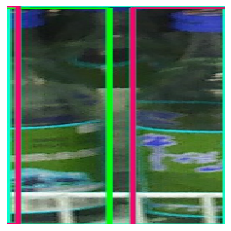

9 五粮醇 0.5626795887947083


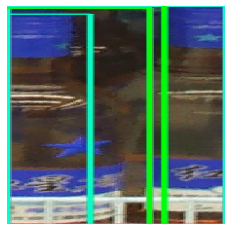

90 牛栏山41.6度小牛白酒500ml 0.7371656894683838


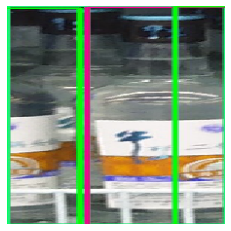

9 五粮醇 0.5172468423843384


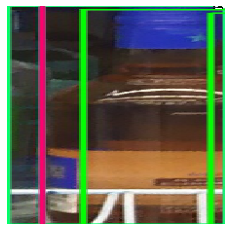

9 五粮醇 0.7387683391571045


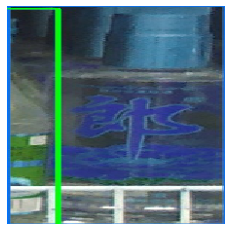

9 五粮醇 0.48914003372192383


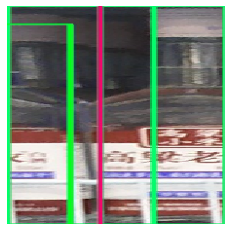

90 牛栏山41.6度小牛白酒500ml 0.5606135129928589


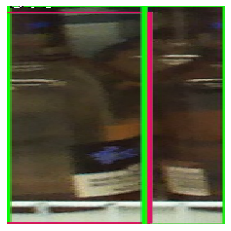

9 五粮醇 0.745840311050415


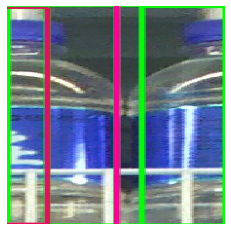

90 牛栏山41.6度小牛白酒500ml 0.9248102903366089


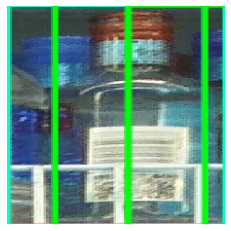

90 牛栏山41.6度小牛白酒500ml 0.991081714630127


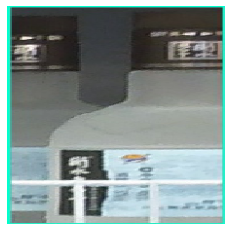

9 五粮醇 0.48181530833244324


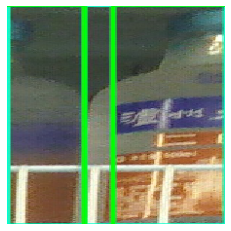

90 牛栏山41.6度小牛白酒500ml 0.7955371141433716


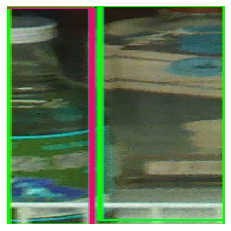

90 牛栏山41.6度小牛白酒500ml 0.837695300579071


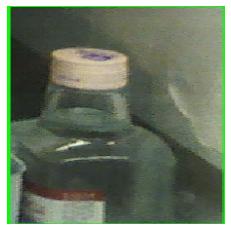

90 牛栏山41.6度小牛白酒500ml 0.9521219730377197


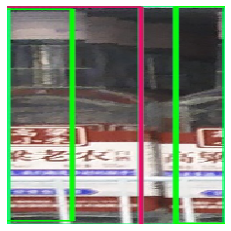

90 牛栏山41.6度小牛白酒500ml 0.7838109135627747


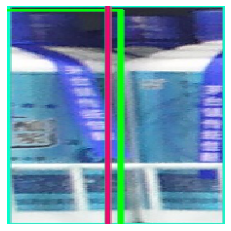

90 牛栏山41.6度小牛白酒500ml 0.6531275510787964


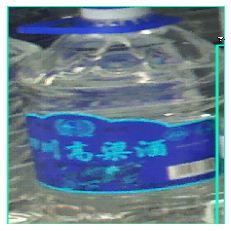

9 五粮醇 0.7176942229270935


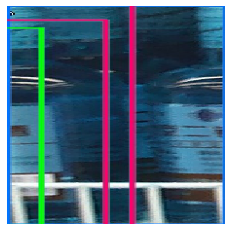

9 五粮醇 0.661139726638794


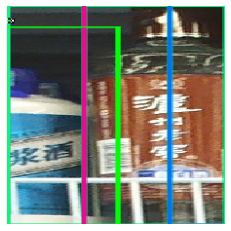

9 五粮醇 0.3840367794036865


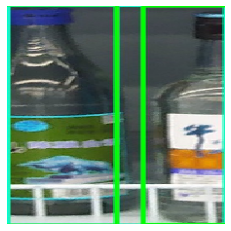

90 牛栏山41.6度小牛白酒500ml 0.7145716547966003


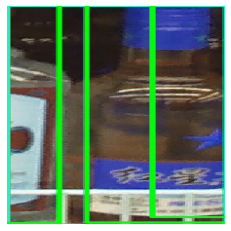

100 牛栏山42度陈酿白酒500ml 0.21675439178943634


/root/.local/lib/python3.8/site-packages/keras_retinanet/utils/colors.py:18: UserWarning: Label 100 has no color, returning default.
  warnings.warn('Label {} has no color, returning default.'.format(label))


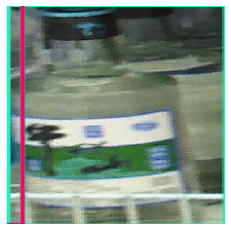

90 牛栏山41.6度小牛白酒500ml 0.5099616646766663


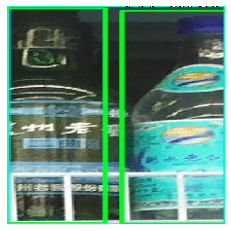

47 小郎酒45度 0.7424064874649048


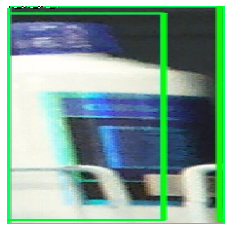

9 五粮醇 0.7095656394958496
processing time:  412.5523524284363


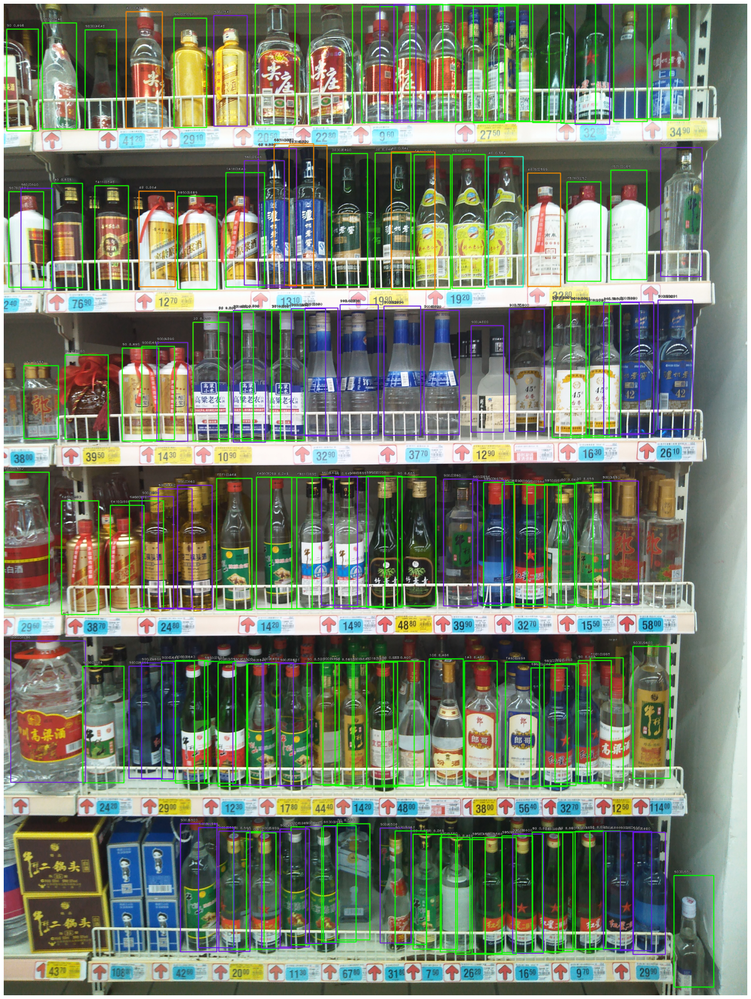

In [34]:
# 商品识别和可视化
for box, score, label in zip(boxes[0], scores[0], labels[0]):
    # 过滤小于0.5检测框
    if score < 0.5:
        break
    
    # 分类框颜色（复用RetinaNet可视化模块，颜色类别可能不够用）
    color = label_color(label)
    b = box.astype(int)
    
    # 检测框中的SKU小图
    cropped = draw[b[1]:b[3], b[0]:b[2]]
    if cropped is not None:
        image_path = f"test/{idx}.jpg"
        # 保存SKU小图结果
        cv2.imwrite(image_path, cropped)    
        # 商品识别
        img_tensor = load_image(image_path)
        pred = classifier.predict(img_tensor)
        
        sku_id = np.argmax(pred)
        sku_name = classifier_class_name[sku_id]
        sku_score = np.max(pred)
        # 添加SKU分类结果
        predict_list.append(sku_name)
        # 打印识别结果
        print(f"{sku_id} {sku_name} {sku_score}")
        # 在货架图中可视化分类结果
        caption = "{} {:.3f}".format(sku_id, sku_score)
        draw_caption(draw, b, caption)
        draw_box(draw, b, color=label_color(sku_id))
    
        idx+=1
    
print("processing time: ", time.time() - start)
plt.figure(figsize=(25, 45))
plt.axis('off')
plt.imshow(draw)
plt.show()

70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 0.9999653100967407
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
16 北京二锅头56度5L 1.0
145 老白干桶装 0.9999998807907104
103 牛栏山43度珍品陈酿白酒500ml 0.9346027970314026
16 北京二锅头56度5L 0.9999985694885254
16 北京二锅头56度5L 0.7050092220306396
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 0.9999988079071045
70 泸州老白干52度2.5L、5L 0.9999997615814209
70 泸州老白干52度2.5L、5L 1.0
103 牛栏山43度珍品陈酿白酒500ml 0.9510823488235474
70 泸州老白干52度2.5L、5L 0.9999998807907104
70 泸州老白干52度2.5L、5L 0.9999440908432007
70 泸州老白干52度2.5L、5L 1.0
103 牛栏山43度珍品陈酿白酒500ml 0.998608410358429
70 泸州老白干52度2.5L、5L 0.9992517828941345
70 泸州老白干52度2.5L、5L 0.9999644756317139
70 泸州老白干52度2.5L、5L 1.0
70 泸州老白干52度2.5L、5L 1.0
103 牛栏山43度珍品陈酿白酒500ml 0.9999880790710449
70 泸州老白干52度2.5L、5L 0.9989469647407532
70 泸州老白干52度2.5L、5L 0.9974749684333801
145 老白干桶装 0.8700411319732666
103 牛栏山43度珍品陈酿白酒500ml 1.0
103 牛

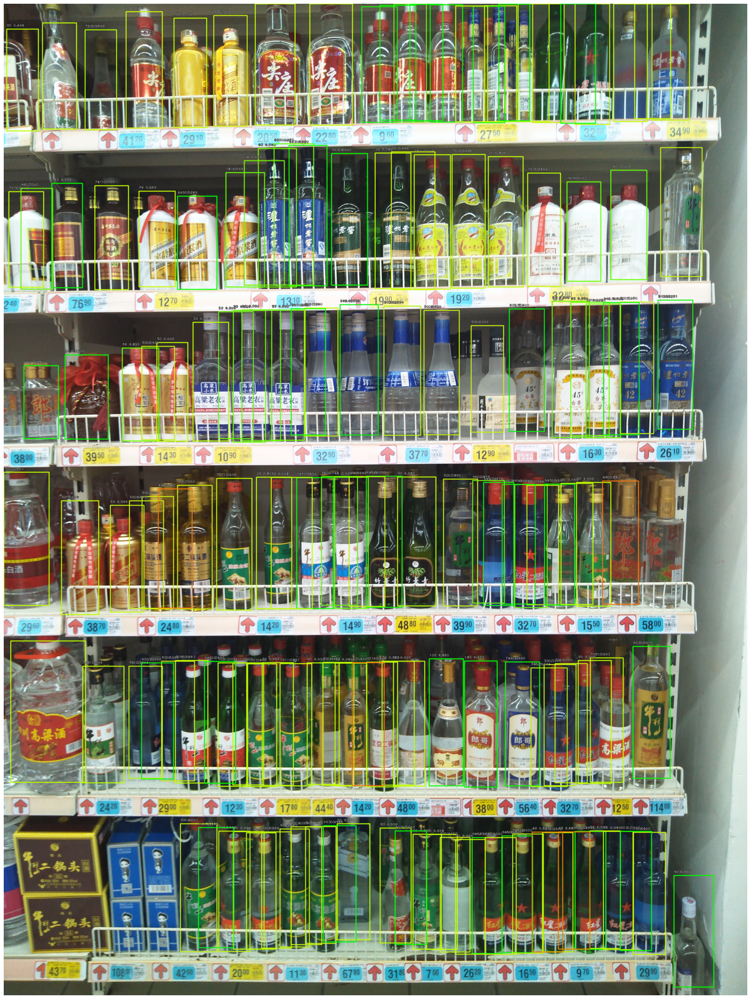

In [33]:
# 商品识别和可视化
for box, score, label in zip(boxes[0], scores[0], labels[0]):
    # 过滤小于0.5检测框
    if score < 0.5:
        break
    
    # 分类框颜色（复用RetinaNet可视化模块，颜色类别可能不够用）
    color = label_color(label)
    b = box.astype(int)
    
    # 检测框中的SKU小图
    cropped = draw[b[1]:b[3], b[0]:b[2]]
    if cropped is not None:
        #image_path = f"test/{idx}.jpg"
        # 保存SKU小图结果
        #cv2.imwrite(image_path, cropped)    
        # 商品识别
        #img_tensor = load_image(image_path)
        pred = classifier.predict(np.expand_dims(cropped, axis=0))
        
        sku_id = np.argmax(pred)
        sku_name = classifier_class_name[sku_id]
        sku_score = np.max(pred)
        # 添加SKU分类结果
        predict_list.append(sku_name)
        # 打印识别结果
        print(f"{sku_id} {sku_name} {sku_score}")
        # 在货架图中可视化分类结果
        caption = "{} {:.3f}".format(sku_id, sku_score)
        draw_caption(draw, b, caption)
        draw_box(draw, b, color=label_color(sku_id))
    
        idx+=1
    
print("processing time: ", time.time() - start)
plt.figure(figsize=(25, 45))
plt.axis('off')
plt.imshow(draw)
plt.show()